DIFFUSION INTERVENTIONS

In [1]:
from nnsight.models.DiffusionModel import DiffusionModel
import torch
from PIL import Image
model = DiffusionModel("CompVis/stable-diffusion-v1-4", dispatch=True).to('cuda:0')

/share/u/imgr/miniconda3/envs/nnsight/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Keyword arguments {'trust_remote_code': True} are not expected by StableDiffusionPipeline and will be ignored.
Loading pipeline components...: 100%|██████████| 7/7 [00:00<00:00, 13.49it/s]


In [2]:
import matplotlib.pyplot as plt

100%|██████████| 50/50 [00:05<00:00,  8.63it/s]


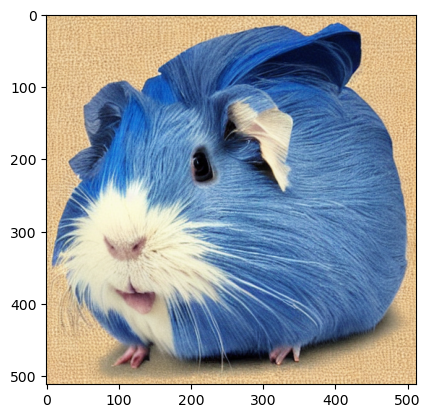

In [16]:
generator = torch.Generator()
generator.manual_seed(40)
with model.generate('blue guinea pig', num_inference_steps=50, generator=generator, validate=False, scan=False):
    zzz = model.output.save()
with model.generate('blue guinea pig', num_inference_steps=50, generator=generator, validate=False, scan=False):
    zzz2 = model.output.save()
plt.imshow(zzz.images[0])
plt.imshow(zzz2.images[0])

<div style="text-align:center;">
    <img src="img/diff1-4img.jpg" alt="title" width="600">
</div>

In [4]:
#LAYER PATHS IN THE RIGHT ORDER

my_self_layers =[
    '.unet.down_blocks.0.attentions.0.transformer_blocks.0.attn1',
    '.unet.down_blocks.0.attentions.1.transformer_blocks.0.attn1',
    '.unet.down_blocks.1.attentions.0.transformer_blocks.0.attn1',
    '.unet.down_blocks.1.attentions.1.transformer_blocks.0.attn1',
    '.unet.down_blocks.2.attentions.0.transformer_blocks.0.attn1',
    '.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn1',
    '.unet.mid_block.attentions.0.transformer_blocks.0.attn1',
    '.unet.up_blocks.1.attentions.0.transformer_blocks.0.attn1',
    '.unet.up_blocks.1.attentions.1.transformer_blocks.0.attn1',
    '.unet.up_blocks.1.attentions.2.transformer_blocks.0.attn1',
    '.unet.up_blocks.2.attentions.0.transformer_blocks.0.attn1',
    '.unet.up_blocks.2.attentions.1.transformer_blocks.0.attn1',
    '.unet.up_blocks.2.attentions.2.transformer_blocks.0.attn1',
    '.unet.up_blocks.3.attentions.0.transformer_blocks.0.attn1',
    '.unet.up_blocks.3.attentions.1.transformer_blocks.0.attn1',
    '.unet.up_blocks.3.attentions.2.transformer_blocks.0.attn1'
]

my_cross_layers =[
    '.unet.down_blocks.0.attentions.0.transformer_blocks.0.attn2',
    '.unet.down_blocks.0.attentions.1.transformer_blocks.0.attn2',
    '.unet.down_blocks.1.attentions.0.transformer_blocks.0.attn2',
    '.unet.down_blocks.1.attentions.1.transformer_blocks.0.attn2',
    '.unet.down_blocks.2.attentions.0.transformer_blocks.0.attn2',
    '.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2',
    '.unet.mid_block.attentions.0.transformer_blocks.0.attn2',
    '.unet.up_blocks.1.attentions.0.transformer_blocks.0.attn2',
    '.unet.up_blocks.1.attentions.1.transformer_blocks.0.attn2',
    '.unet.up_blocks.1.attentions.2.transformer_blocks.0.attn2',
    '.unet.up_blocks.2.attentions.0.transformer_blocks.0.attn2',
    '.unet.up_blocks.2.attentions.1.transformer_blocks.0.attn2',
    '.unet.up_blocks.2.attentions.2.transformer_blocks.0.attn2',
    '.unet.up_blocks.3.attentions.0.transformer_blocks.0.attn2',
    '.unet.up_blocks.3.attentions.1.transformer_blocks.0.attn2',
    '.unet.up_blocks.3.attentions.2.transformer_blocks.0.attn2'
]

In [ ]:
#ELEMENTS OF ONE LAYER

#6TH SELF ATTN
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn1
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn1.to_q
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn1.to_k
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn1.to_v
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn1.to_out
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn1.to_out.0
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn1.to_out.1

#6TH CROSS ATTN
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_q
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_k
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_v
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_out
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_out.0
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_out.1

In [14]:
shapes = []
with model.generate('purple woodpecker', num_inference_steps=50, generator=generator, validate=False, scan=False): #
        
    modules = model._envoy.envoys(lambda envoy : envoy._module_path.startswith('.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2'))

    for module in modules:
        print(module._module_path, module.output)
        #shapes.append((module._module_path, module.output.shape.save()))

.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2 InterventionProxy (argument_1): <class 'inspect._empty'>
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_q InterventionProxy (argument_2): <class 'inspect._empty'>
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_k InterventionProxy (argument_3): <class 'inspect._empty'>
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_v InterventionProxy (argument_4): <class 'inspect._empty'>
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_out [InterventionProxy (argument_5): <class 'inspect._empty'>, InterventionProxy (argument_6): <class 'inspect._empty'>]
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_out.0 InterventionProxy (argument_5): <class 'inspect._empty'>
.unet.down_blocks.2.attentions.1.transformer_blocks.0.attn2.to_out.1 InterventionProxy (argument_6): <class 'inspect._empty'>


100%|██████████| 50/50 [00:05<00:00,  8.63it/s]


In [15]:
#Embedding for empty prompt
prompt_embeds, negative_prompt_embeds = model.pipeline.encode_prompt("", torch.device("cuda"), 1, False, None) #tokens for empty prompt
# if model.pipeline.do_classifier_free_guidance:
#     prompt_embeds = torch.cat([negative_prompt_embeds, prompt_embeds])

In [30]:
def inspect_module(m, how, other):
    generator.manual_seed(40)
    with model.generate('purple woodpecker', num_inference_steps=50, generator=generator, validate=False, scan=False): #
        
        modules = model._envoy.envoys(lambda envoy : envoy._module_path.endswith('attn1') or envoy._module_path.endswith('attn2')) #for all self and cross attn right now

        for module in modules:
            #print(module._module_path)
            #print(module)    

            if module._module_path != my_self_layers[m]:
                if other == 'keep':
                    pass
                else:
                    for i in range(0, 50): #timesteps          
                        if i != 0:
                            module.next() #this is how you tell the module that we are working with the next iteration

                        if other == 'ablate':
                            module.output[:] = 0 #ablate the attention map
                        
                        if other == 'emptyprompt':
                            module.input[1]['encoder_hidden_states'] = prompt_embeds #give it the attention map for empty prompt
                        
                        if other == 'keep':
                            pass
                    
            else:
                if how == 'keep':
                    print('KEPT ONLY', module._module_path)
                
                elif how == 'increase':
                    for i in range(0, 50): #timesteps          
                        if i != 0:
                            module.next() #this is how you tell the module that we are working with the next iteration
                            module.output[:] = .2

                #TO PLAY WITH TIMESTEPS
                # for i in range(50): #timesteps  
                #     if i != 0:
                #         module.next() #this is how you tell the module that we are working with the next iteration
                        
                    #module.output[:] = 0 #ablates output
                    #shapes.append((module._module_path, module.output.shape.save()))
        
        zzz = model.output.save()
    return zzz
    #plt.imshow(zzz.images[0])
    #return(zzz.images[0])

#             zzz = model.output.save()

#     plt.subplot(1, 16, m+1)
#     plt.imshow(zzz.images[0])
# plt.show

#zzz.images[0].save('try.png')

INCREASE & ABLATE

100%|██████████| 50/50 [00:05<00:00,  8.61it/s]
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
100%|██████████| 50/50 [00:05<00:00,  8.50it/s]
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
100%|██████████| 50/50 [00:05<00:00,  8.48it/s]
Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
100%|██████████| 50/50 [00:05<00:00,  8.42it/s]


<function matplotlib.pyplot.show(close=None, block=None)>

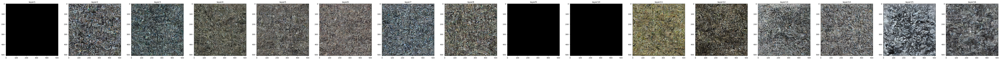

In [9]:
plt.figure(figsize=(100,20))
for m in range(16):
    zzz = inspect_module(m, 'increase', 'ablate')
    plt.subplot(1, 16, m+1)
    plt.title(f"layer{m+1}")
    plt.imshow(zzz.images[0])
plt.show

100%|██████████| 50/50 [00:05<00:00,  8.41it/s]


<function matplotlib.pyplot.show(close=None, block=None)>

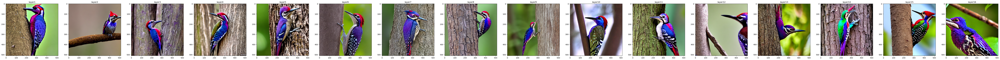

In [10]:
plt.figure(figsize=(100,20))
for m in range(16):
    zzz = inspect_module(m, 'increase', 'emptyprompt')
    plt.subplot(1, 16, m+1)
    plt.title(f"layer{m+1}")
    plt.imshow(zzz.images[0])
plt.show

INCREASE SELF ATTN LAYER & NOTHING

 34%|███▍      | 17/50 [00:02<00:03,  8.73it/s]

100%|██████████| 50/50 [00:05<00:00,  8.41it/s]


<function matplotlib.pyplot.show(close=None, block=None)>

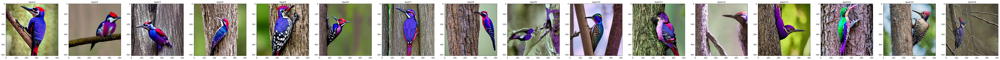

In [31]:
plt.figure(figsize=(100,20))
for m in range(16):
    zzz = inspect_module(m, 'increase', 'keep')
    plt.subplot(1, 16, m+1)
    plt.title(f"layer{m+1}")
    plt.imshow(zzz.images[0])
plt.show